In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import rcParams
import numpy as np
from scipy import signal
from sklearn.preprocessing import LabelEncoder
import mne

# Visualização e pré-processamento

A seguir, a implementação de cada um dos filtros: passa-faixa (bandpass), passa-baixa (lowpass), passa-alta (highpass) e corta-faixa (notch).

In [2]:
def butter_bandpass(data, lowcut, highcut, fs=512, order=4):
    nyq = fs * 0.5
    low = lowcut / nyq
    high = highcut / nyq
    b, a = signal.butter(order, [low, high], btype='bandpass')
    return signal.filtfilt(b, a, data)


def butter_lowpass(data, lowcut, fs=512, order=4):
    nyq = fs * 0.5
    low = lowcut / nyq
    b, a = signal.butter(order, low, btype='lowpass')
    return signal.filtfilt(b, a, data)


def butter_highpass(data, highcut, fs=512, order=4):
    nyq = fs * 0.5
    high = highcut / nyq
    b, a = signal.butter(order, high, btype='highpass')
    return signal.filtfilt(b, a, data)


def butter_notch(data, cutoff, var=1, fs=512, order=4):
    nyq = fs * 0.5
    low = (cutoff - var) / nyq
    high = (cutoff + var) / nyq
    b, a = signal.iirfilter(order, [low, high], btype='bandstop', ftype="butter")
    return signal.filtfilt(b, a, data)

Para imprimir os dados no domínio da frequência, foi utilizado a função matplotlib.pyplot.psd que na verdade utiliza a transformação dos dados por FFT, porém aplica uma característica que evidencia a "energia" dos dados, chamado de PSD (Power Spectrum Density)

Definição de função para imprimir os dados no domínio do tempo e da frequência:

In [3]:
targets = 40

def print_graphs(data):
    for i in range(0, targets, 3):
        plt.plot(data[i,:])
    plt.title('Domínio do tempo')
    plt.show()

    for i in range(0, targets, 3):
        plt.psd(data[i,:], Fs=512)
    plt.title('Domínio da frequência')
    plt.show()

    for i in range(0, targets, 3):
        plt.specgram(data[i,:], Fs=512)
    plt.title('Domínio da frequência')
    plt.show()

Carregamento dos dados de um participante da base de dados Beta:



In [35]:
data = np.load("../../datasets/beta/data.npy")

Visualização do sinal em todos os domínios apresentados, sem a aplicação de nenhum filtro:



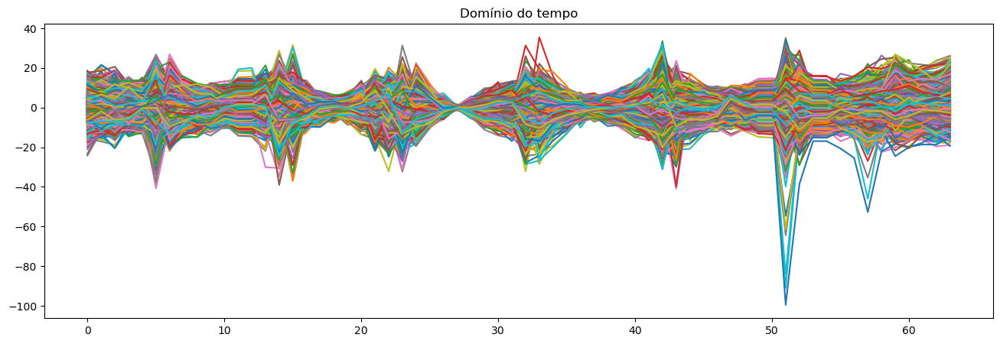

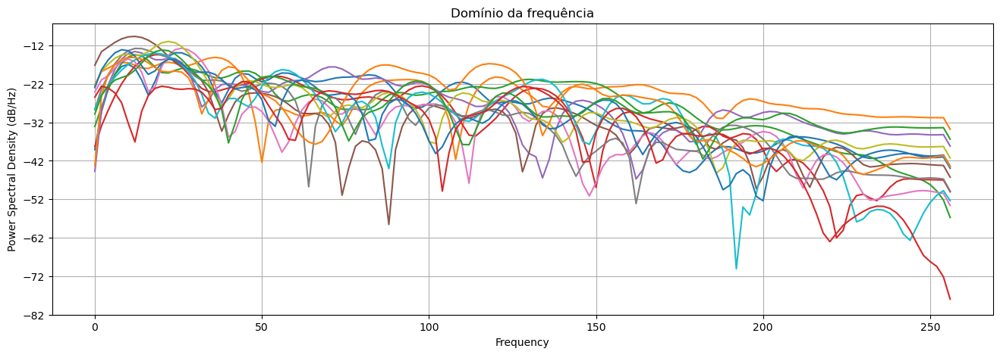

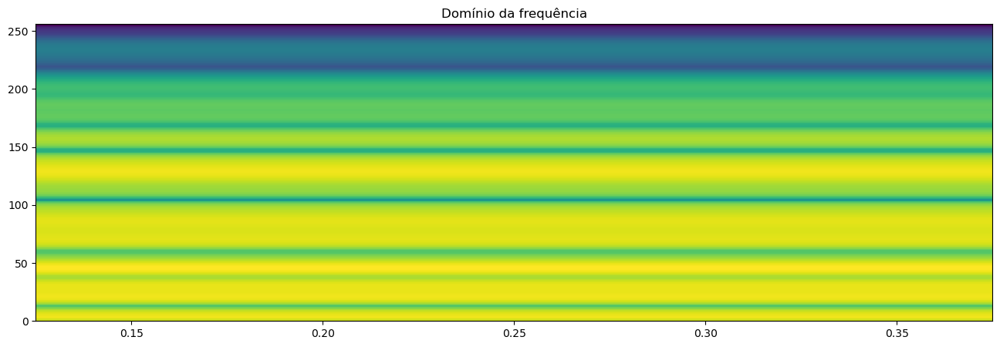

In [36]:
rcParams['figure.figsize'] = [16., 5.]
print_graphs(data)

Para facilitar o trabalho de visualização dos dados nas faixas de frequência de trabalho, vamos utilizar a ferramenta MNE:


In [37]:
# criação de um objeto "info"
n_channels = 64
sfreq = 512
ch_names = ["FP1", "FPZ", "FP2", "AF3", "AF4", "F7", "F5", "F3", "F1", "FZ", "F2", "F4", "F6", "F8", "FT7", "FC5", "FC3", "FC1", "FCZ", "FC2", "FC4", "FC6", "FT8", "T7", "C5", "C3", "C1", "CZ", "C2", "C4", "C6", "T8", "M1", "TP7", "CP5", "CP3", "CP1", "CPZ", "CP2", "CP4", "CP6", "TP8", "M2", "P7", "P5", "P3", "P1", "PZ", "P2", "P4", "P6", "P8", "PO7", "PO5", "PO3", "POZ", "PO4", "PO6", "PO8", "CB1", "O1", "OZ", "O2", "CB2"] # colocar todos os eletrodos
ch_types = ['eeg'] * n_channels # colocar todos os eletrodos
info = mne.create_info(ch_names, sfreq=sfreq, ch_types=ch_types)
info

<Info | 7 non-empty values
 bads: []
 ch_names: FP1, FPZ, FP2, AF3, AF4, F7, F5, F3, F1, FZ, F2, F4, F6, F8, ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 256.0 Hz
 meas_date: unspecified
 nchan: 64
 projs: []
 sfreq: 512.0 Hz
>

In [45]:
from sklearn.preprocessing import LabelEncoder

labels = np.load("../../datasets/beta/labels.npy")
print(labels, labels.shape)
event_dict = {str(value): index  for index, value in enumerate(sorted(set(labels)))}
event_dict

[ 8.6  8.8  9.   9.2  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2
 11.4 11.6 11.8 12.  12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.
 14.2 14.4 14.6 14.8 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8
  9.   9.2  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6
 11.8 12.  12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4
 14.6 14.8 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8  9.   9.2
  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6 11.8 12.
 12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4 14.6 14.8
 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8  9.   9.2  9.4  9.6
  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6 11.8 12.  12.2 12.4
 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4 14.6 14.8 15.  15.2
 15.4 15.6 15.8  8.   8.2  8.4] (160,)


{'8.0': 0,
 '8.2': 1,
 '8.4': 2,
 '8.6': 3,
 '8.799999999999999': 4,
 '9.0': 5,
 '9.2': 6,
 '9.4': 7,
 '9.6': 8,
 '9.8': 9,
 '10.0': 10,
 '10.2': 11,
 '10.4': 12,
 '10.6': 13,
 '10.8': 14,
 '11.0': 15,
 '11.2': 16,
 '11.4': 17,
 '11.6': 18,
 '11.8': 19,
 '12.0': 20,
 '12.2': 21,
 '12.4': 22,
 '12.600000000000001': 23,
 '12.8': 24,
 '13.0': 25,
 '13.200000000000001': 26,
 '13.4': 27,
 '13.600000000000001': 28,
 '13.8': 29,
 '14.0': 30,
 '14.200000000000001': 31,
 '14.4': 32,
 '14.600000000000001': 33,
 '14.8': 34,
 '15.0': 35,
 '15.200000000000001': 36,
 '15.4': 37,
 '15.600000000000001': 38,
 '15.8': 39}

In [46]:
# data : array, shape (n_epochs, n_channels, n_times)
data_correct = data
# data_correct = data

# método para transformar labels categóricos
le = LabelEncoder()
events = np.column_stack((
    np.array(range(len(labels))),
    np.zeros(160, dtype=int),
    le.fit_transform(labels)
))

# events

data_correct.shape

mne_data = mne.EpochsArray(data_correct, info, events, event_id=event_dict)
mne_data

Not setting metadata
160 matching events found
No baseline correction applied
0 projection items activated


Number of events,160
Events,10.0: 410.2: 410.4: 410.6: 410.8: 411.0: 411.2: 411.4: 411.6: 411.8: 412.0: 412.2: 412.4: 412.600000000000001: 412.8: 413.0: 413.200000000000001: 413.4: 413.600000000000001: 413.8: 414.0: 414.200000000000001: 414.4: 414.600000000000001: 414.8: 415.0: 415.200000000000001: 415.4: 415.600000000000001: 415.8: 48.0: 48.2: 48.4: 48.6: 48.799999999999999: 49.0: 49.2: 49.4: 49.6: 49.8: 4
Time range,0.000 – 1.951 s
Baseline,off


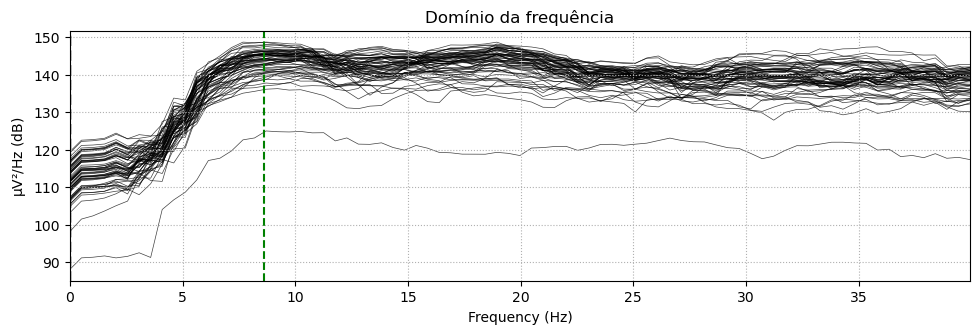

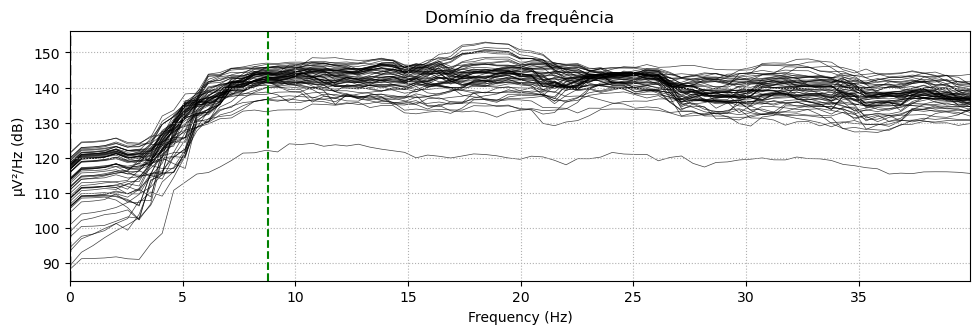

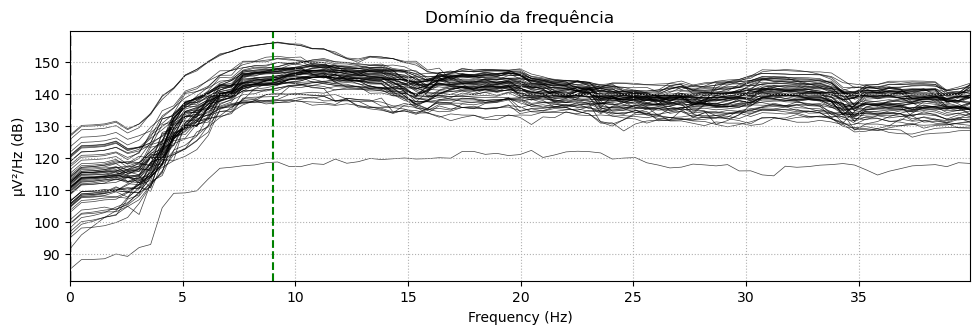

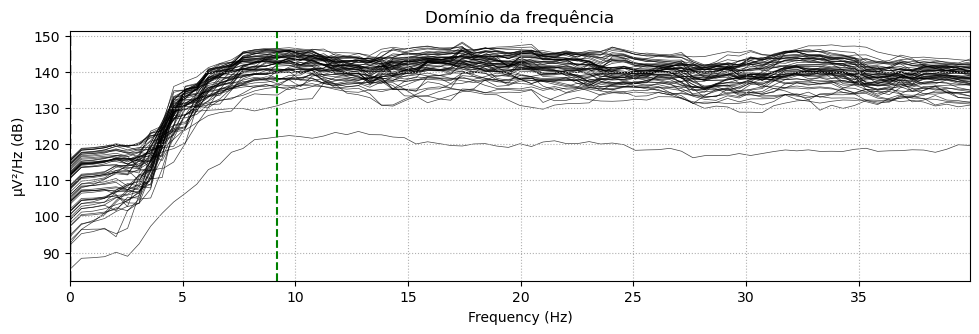

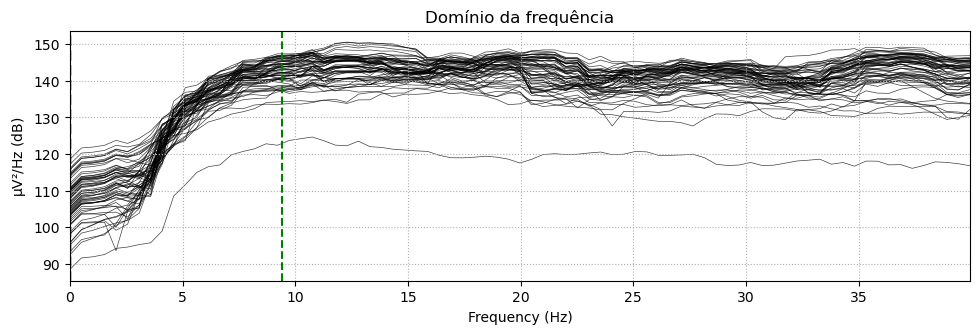

...

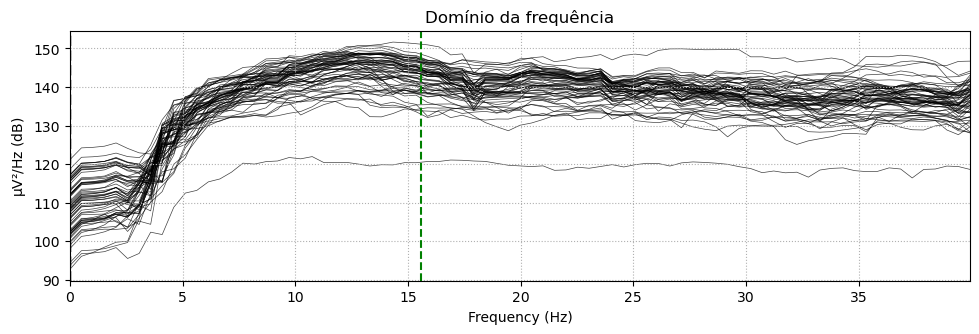

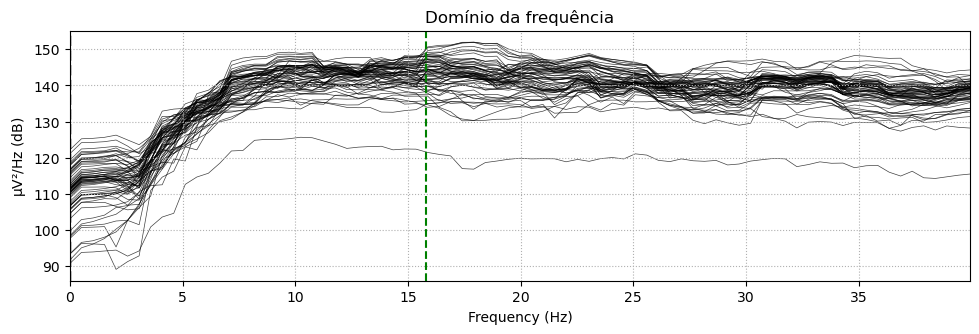

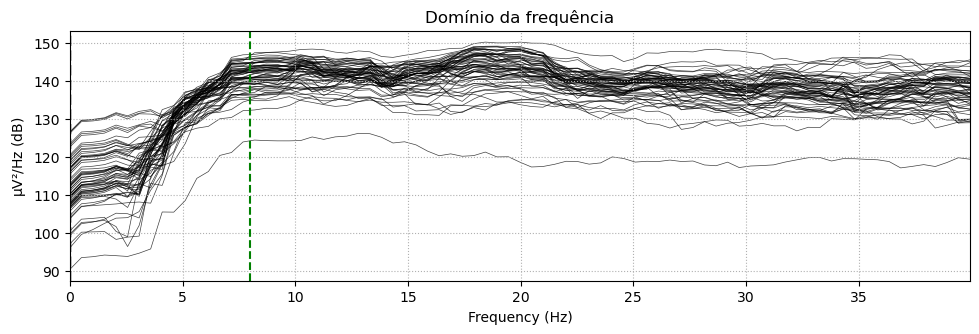

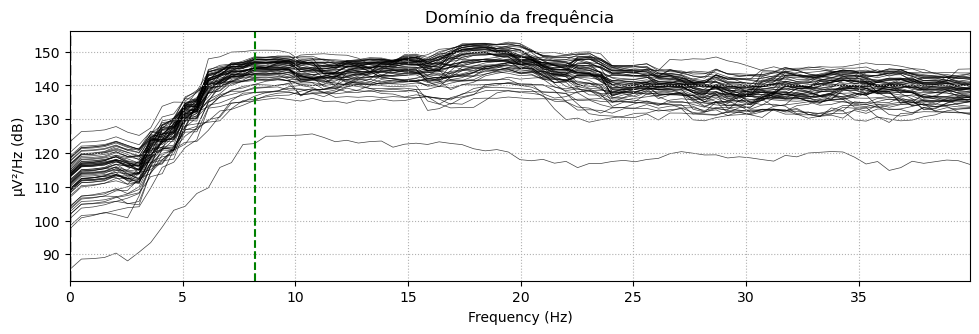

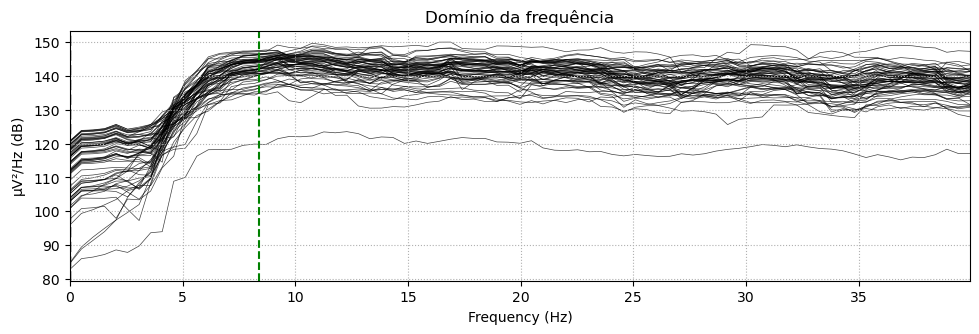

In [49]:
import warnings
warnings.filterwarnings('ignore')

for i in range(len(mne_data)):
    # view = mne_data.compute_psd(method='welch', fmin=3, fmax=13)
    view = mne_data[i].compute_psd(method='multitaper', fmin=0, fmax=40,
                                   verbose=False)
    view.plot(show=False)
    print()
    plt.title('Domínio da frequência')
    plt.axvline(x=float(list(mne_data[i].event_id)[0]), linestyle='--',
                color='green')
    plt.show()
print()

In [50]:
# aplicando o filtro
mne_data_filtered = mne_data.filter(l_freq=7., h_freq=15) #7,5%
# mne_data_filtered = mne_data.filter(l_freq=8., h_freq=14)


# salvando os dados
mne_data_filtered.save(fname="../../datasets/beta/mne_data.fif", overwrite=True)

Setting up band-pass filter from 7 - 15 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 7.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Upper passband edge: 15.00 Hz
- Upper transition bandwidth: 3.75 Hz (-6 dB cutoff frequency: 16.88 Hz)
- Filter length: 845 samples (1.650 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s


Overwriting existing file.


[Parallel(n_jobs=1)]: Done 10240 out of 10240 | elapsed:    0.6s finished
